In [2]:
import numpy as np
import pandas as pd
import tensorflow as tf
from tensorflow import keras as keras
import matplotlib.pyplot as plt
import seaborn as sns
from PIL import Image
import os
import keras_cv
from tensorflow.keras.preprocessing.image import ImageDataGenerator
!pip install ultralytics
from ultralytics import YOLO
import cv2

2024-06-09 06:20:39.223906: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-06-09 06:20:39.224007: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-06-09 06:20:39.336447: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
/opt/conda/lib/python3.10/pty.py:89: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  pid, fd = os.forkpty()


     ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 41.2/41.2 kB 2.1 MB/s eta 0:00:00
   ━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━━ 780.5/780.5 kB 19.2 MB/s eta 0:00:0000:01


## Analyzing Given ML Model outputs:

In [4]:
def merge_and_categorize_results(root_dir):
    # Initialize dictionaries to categorize detections
    high_accuracy = {'Label': [], 'Score': []}
    medium_accuracy = {'Label': [], 'Score': []}
    low_accuracy = {'Label': [], 'Score': []}
    poor_accuracy = {'Label': [], 'Score': []}

    # Iterate over each person's folder
    for person_folder in os.listdir(root_dir):
        person_path = os.path.join(root_dir, person_folder)
        if os.path.isdir(person_path):
            # Iterate over each CSV file in the person's folder
            for file in os.listdir(person_path):
                if file.endswith('.csv'):
                    csv_path = os.path.join(person_path, file)
                    df = pd.read_csv(csv_path, encoding='latin-1')  # Specify encoding here
                    # Categorize detections based on accuracy score
                    for index, row in df.iterrows():
                        score = row['Score']
                        if score > 0.9:
                            high_accuracy['Label'].append(row['Label'])
                            high_accuracy['Score'].append(score)
                        elif score > 0.7 and score <= 0.9:
                            medium_accuracy['Label'].append(row['Label'])
                            medium_accuracy['Score'].append(score)
                        elif score > 0.5 and score <= 0.7:
                            low_accuracy['Label'].append(row['Label'])
                            low_accuracy['Score'].append(score)
                        else:
                            poor_accuracy['Label'].append(row['Label'])
                            poor_accuracy['Score'].append(score)
    
    # Convert dictionaries to dataframes
    high_accuracy_df = pd.DataFrame(high_accuracy)
    medium_accuracy_df = pd.DataFrame(medium_accuracy)
    low_accuracy_df = pd.DataFrame(low_accuracy)
    poor_accuracy_df = pd.DataFrame(poor_accuracy)
    
    return high_accuracy_df, medium_accuracy_df, low_accuracy_df, poor_accuracy_df

root_directory = '/kaggle/input/cgcs-objectsearch'  # Adjust the root directory path
high_acc, medium_acc, low_acc, poor_acc = merge_and_categorize_results(root_directory)
df_high_acc_grouped = high_acc.groupby('Label')['Score'].transform('max')
df_high_acc_filtered = high_acc[high_acc['Score'] == df_high_acc_grouped]


print(df_high_acc_filtered)
print("\n")

df_medium_acc_grouped = medium_acc.groupby('Label')['Score'].transform('max')
df_medium_acc_filtered = medium_acc[medium_acc['Score'] == df_medium_acc_grouped]


print(df_medium_acc_filtered)
print("\n")
df_low_acc_grouped = low_acc.groupby('Label')['Score'].transform('max')
df_low_acc_filtered = low_acc[low_acc['Score'] == df_low_acc_grouped]


print(df_low_acc_filtered)
print("\n")
df_poor_acc_grouped = poor_acc.groupby('Label')['Score'].transform('max')
df_poor_acc_filtered = poor_acc[poor_acc['Score'] == df_poor_acc_grouped]


print(df_poor_acc_filtered)

            Label    Score
0  vancouverCards  0.91195
2     lavenderDie  0.91488
4      paperPlate  0.97645


            Label    Score
5            sign  0.75164
8     lavenderDie  0.84824
11  yellowBalloon  0.72378
26      yellowBag  0.79260
27      cloudSign  0.72959
29   pumpkinNotes  0.80800
40       hairClip  0.89167
53     paperPlate  0.87532
56        eyeball  0.81999
60     redWhistle  0.88976
79     noisemaker  0.83048
88     stickerBox  0.88468


              Label    Score
12         birdCall  0.66718
40       pinkCandle  0.69965
63       redWhistle  0.69453
69           trophy  0.67478
116      partyFavor  0.50319
121        metalKey  0.66809
131         eyeball  0.63190
138   yellowBalloon  0.67832
191    canadaPencil  0.57062
197    pumpkinNotes  0.68924
253        hairClip  0.69670
260            sign  0.69006
278  blueSunglasses  0.61751
279       yellowBag  0.64344
300     lavenderDie  0.69549
345    cupcakePaper  0.60502
386      stickerBox  0.59883
396      paperP

## Training Custom YOLOv8 model for Object detection

In [3]:
import torch
import torch.nn as nn
# device = torch.device("cuda" if torch.cuda.is_available() else 'cpu')
yolo_model_v8  = YOLO(model ="yolov8m.pt")
# yolo_model_v8 = nn.DataParallel(yolo_model_v8)
# yolo_model_v8.to(device)

In [4]:
from IPython.display import Image, display

# Function to display images
def display_image(path):
    display(Image(filename=path))

## Question 1: Examine the outputs from the model – either from the detection results provided or the results from a model you chose. Which objects were identified well by the model and which were not?

In [ ]:
# yolov8_model_2 = YOLO(model ="yolov8m.pt")

# wandbai api key: 0b73cfeabc06bc77f18f7c8f96c2c88952f904f5

In [4]:
yolov8_history = yolo_model_v8.train(data = '/kaggle/input/yolov8-config-final/yolov8_config.yaml', epochs = 50, imgsz = 640, save = True, plots = True)

Ultralytics YOLOv8.2.28 🚀 Python-3.10.13 torch-2.1.2 CUDA:0 (Tesla P100-PCIE-16GB, 16276MiB)
engine/trainer: task=detect, mode=train, model=yolov8m.pt, data=/kaggle/input/yolov8-config-final/yolov8_config.yaml, epochs=50, time=None, patience=100, batch=16, imgsz=640, save=True, save_period=-1, cache=False, device=None, workers=8, project=None, name=train, exist_ok=False, pretrained=True, optimizer=auto, verbose=True, seed=0, deterministic=True, single_cls=False, rect=False, cos_lr=False, close_mosaic=10, resume=False, amp=True, fraction=1.0, profile=False, freeze=None, multi_scale=False, overlap_mask=True, mask_ratio=4, dropout=0.0, val=True, split=val, save_json=False, save_hybrid=False, conf=None, iou=0.7, max_det=300, half=False, dnn=False, plots=True, source=None, vid_stride=1, stream_buffer=False, visualize=False, augment=False, agnostic_nms=False, classes=None, retina_masks=False, embed=None, show=False, save_frames=False, save_txt=False, save_conf=False, save_crop=False, show_la

100%|██████████| 755k/755k [00:00<00:00, 18.6MB/s]
2024-06-07 16:41:25,356	INFO util.py:124 -- Outdated packages:
  ipywidgets==7.7.1 found, needs ipywidgets>=8
Run `pip install -U ipywidgets`, then restart the notebook server for rich notebook output.
2024-06-07 16:41:25,797	INFO util.py:124 -- Outdated packages:
  ipywidgets==7.7.1 found, needs ipywidgets>=8
Run `pip install -U ipywidgets`, then restart the notebook server for rich notebook output.


Overriding model.yaml nc=80 with nc=43

                   from  n    params  module                                       arguments                     
  0                  -1  1      1392  ultralytics.nn.modules.conv.Conv             [3, 48, 3, 2]                 
  1                  -1  1     41664  ultralytics.nn.modules.conv.Conv             [48, 96, 3, 2]                
  2                  -1  2    111360  ultralytics.nn.modules.block.C2f             [96, 96, 2, True]             
  3                  -1  1    166272  ultralytics.nn.modules.conv.Conv             [96, 192, 3, 2]               
  4                  -1  4    813312  ultralytics.nn.modules.block.C2f             [192, 192, 4, True]           
  5                  -1  1    664320  ultralytics.nn.modules.conv.Conv             [192, 384, 3, 2]              
  6                  -1  4   3248640  ultralytics.nn.modules.block.C2f             [384, 384, 4, True]           
  7                  -1  1   1991808  ultralytic

wandb: Logging into wandb.ai. (Learn how to deploy a W&B server locally: https://wandb.me/wandb-server)
wandb: You can find your API key in your browser here: https://wandb.ai/authorize
wandb: Paste an API key from your profile and hit enter, or press ctrl+c to quit:

  ········································


wandb: Appending key for api.wandb.ai to your netrc file: /root/.netrc


Freezing layer 'model.22.dfl.conv.weight'
AMP: running Automatic Mixed Precision (AMP) checks with YOLOv8n...


100%|██████████| 6.23M/6.23M [00:00<00:00, 124MB/s]


AMP: checks passed ✅


train: Scanning /kaggle/input/cgcs-yolo-training/cgcs-data-yolov5/train/labels... 2704 images, 0 backgrounds, 0 corrupt: 100%|██████████| 2704/2704 [00:17<00:00, 157.60it/s]


train: WARNING ⚠️ Cache directory /kaggle/input/cgcs-yolo-training/cgcs-data-yolov5/train is not writeable, cache not saved.
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 196, len(boxes) = 2838. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/opt/conda/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
val: Scanning /kaggle/input/cgcs-yolo-training/cgcs-data-yolov5/valid/labels... 505 images, 0 backgrounds, 0 corrupt: 100%|██████████| 505/505 [00:03<00:00, 142.12it/s]


val: WARNING ⚠️ Cache directory /kaggle/input/cgcs-yolo-training/cgcs-data-yolov5/valid is not writeable, cache not saved.
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 37, len(boxes) = 516. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.
Plotting labels to runs/detect/train/labels.jpg... 
optimizer: 'optimizer=auto' found, ignoring 'lr0=0.01' and 'momentum=0.937' and determining best 'optimizer', 'lr0' and 'momentum' automatically... 
optimizer: AdamW(lr=0.000213, momentum=0.9) with parameter groups 77 weight(decay=0.0), 84 weight(decay=0.0005), 83 bias(decay=0.0)
TensorBoard: model graph visualization added ✅
Image sizes 640 train, 640 val
Using 4 dataloader workers
Logging results to runs/detect/train
Starting training for 50 epochs...

      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       1/50      9.02G        1.1      2.955      1.359         30        640: 100%|██████████| 169/169 [01:47<00:00,  1.57it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:08<00:00,  1.96it/s]

                   all        505        516      0.761      0.782      0.842      0.658



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       2/50      8.82G      1.001      1.369      1.249         27        640: 100%|██████████| 169/169 [01:44<00:00,  1.61it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.30it/s]

                   all        505        516      0.844      0.849      0.935      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       3/50      8.91G     0.9887      1.154      1.228         32        640: 100%|██████████| 169/169 [01:44<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.34it/s]

                   all        505        516      0.804        0.8      0.907      0.691



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       4/50      8.92G       1.01      1.046      1.245         35        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.34it/s]

                   all        505        516      0.819      0.766      0.867      0.646



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       5/50      8.92G     0.9919       0.94      1.238         32        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.35it/s]

                   all        505        516      0.843      0.893      0.941      0.715



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       6/50      8.81G     0.9546     0.8284        1.2         39        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.35it/s]

                   all        505        516      0.876       0.89      0.931      0.741



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       7/50      8.92G     0.9286     0.7988      1.187         28        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.30it/s]

                   all        505        516      0.922      0.933      0.974      0.746



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       8/50      8.91G     0.9087     0.7179      1.173         35        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.35it/s]

                   all        505        516      0.932       0.96      0.983      0.795



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


       9/50      8.93G     0.8929     0.6896       1.16         31        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.32it/s]

                   all        505        516      0.945      0.945      0.978      0.794



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      10/50       8.8G     0.8691     0.6518      1.155         34        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.33it/s]

                   all        505        516      0.957      0.958      0.986      0.786



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      11/50      8.91G     0.8499     0.6309      1.142         41        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.35it/s]

                   all        505        516      0.914      0.954      0.975       0.79



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      12/50      8.93G     0.8335     0.6001       1.13         35        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.37it/s]

                   all        505        516      0.948      0.962      0.986       0.81



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      13/50      8.91G     0.8093     0.5888      1.116         38        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.37it/s]

                   all        505        516       0.95      0.971      0.987       0.82



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      14/50      8.81G     0.7978     0.5618      1.104         35        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.34it/s]

                   all        505        516      0.951       0.96      0.984      0.821



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      15/50      8.91G     0.7951     0.5687      1.116         27        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.35it/s]

                   all        505        516      0.964      0.982      0.991      0.819



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      16/50       8.9G     0.7941     0.5496      1.106         34        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.31it/s]

                   all        505        516      0.966      0.985      0.989      0.828



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      17/50      8.93G     0.7683     0.5364      1.098         35        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.35it/s]

                   all        505        516      0.957      0.982       0.99      0.837



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      18/50       8.8G     0.7522     0.5169      1.083         36        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.36it/s]

                   all        505        516      0.962      0.969      0.985      0.842



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      19/50      8.92G     0.7327     0.4949      1.076         32        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.37it/s]

                   all        505        516       0.97      0.976      0.989      0.844



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      20/50      8.93G     0.7178     0.4868      1.068         34        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.37it/s]

                   all        505        516      0.974      0.973      0.991      0.841



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      21/50      8.92G     0.7149     0.4731      1.062         44        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.38it/s]

                   all        505        516      0.959      0.983      0.989      0.847



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      22/50       8.8G     0.7018      0.463      1.061         38        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.34it/s]

                   all        505        516      0.976      0.977       0.99      0.843



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      23/50       8.9G     0.7001     0.4613      1.053         37        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.36it/s]

                   all        505        516      0.971      0.977       0.99      0.854



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      24/50       8.9G     0.6881     0.4583      1.046         29        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.34it/s]

                   all        505        516      0.964      0.985      0.992      0.852



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      25/50      8.92G     0.6644     0.4332      1.037         39        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.36it/s]

                   all        505        516      0.959      0.984      0.992      0.856



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      26/50       8.8G     0.6441     0.4337      1.036         37        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.35it/s]

                   all        505        516      0.972      0.978      0.989      0.862



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      27/50      8.91G     0.6344     0.4018       1.02         30        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.37it/s]

                   all        505        516      0.961      0.981      0.989      0.855



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      28/50      8.92G     0.6448     0.4145      1.026         42        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.36it/s]

                   all        505        516      0.965      0.989      0.989      0.861



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      29/50       8.9G     0.6066     0.3935      1.008         41        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.32it/s]

                   all        505        516      0.968      0.986       0.99      0.863



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      30/50       8.8G     0.6189     0.3894      1.017         34        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.35it/s]

                   all        505        516      0.975      0.986      0.994      0.874



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      31/50      8.91G     0.5983     0.3809      1.009         32        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.35it/s]

                   all        505        516      0.976      0.988      0.991      0.878



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      32/50      8.91G     0.5875     0.3737      1.005         30        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.37it/s]

                   all        505        516      0.965      0.979      0.993      0.878



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      33/50      8.92G     0.5855     0.3714     0.9986         28        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.37it/s]

                   all        505        516      0.971       0.98      0.991      0.885



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      34/50      8.81G     0.5758     0.3682     0.9896         40        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.35it/s]

                   all        505        516      0.978      0.978       0.99      0.886



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      35/50      8.91G     0.5621     0.3616     0.9891         37        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.35it/s]

                   all        505        516      0.967      0.984      0.992      0.881



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      36/50      8.92G     0.5568     0.3508     0.9868         27        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.33it/s]

                   all        505        516      0.982      0.991      0.992      0.885



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      37/50      8.93G      0.545     0.3445     0.9842         32        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.35it/s]

                   all        505        516      0.978      0.991      0.992      0.898



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      38/50       8.8G     0.5353     0.3351     0.9757         36        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.37it/s]

                   all        505        516      0.982      0.982      0.992      0.896



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      39/50      8.92G     0.5264     0.3357     0.9702         38        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.38it/s]

                   all        505        516      0.974      0.987      0.992      0.892



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      40/50       8.9G     0.5197     0.3266     0.9773         39        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.37it/s]

                   all        505        516      0.979      0.989      0.994        0.9


Closing dataloader mosaic
albumentations: Blur(p=0.01, blur_limit=(3, 7)), MedianBlur(p=0.01, blur_limit=(3, 7)), ToGray(p=0.01), CLAHE(p=0.01, clip_limit=(1, 4.0), tile_grid_size=(8, 8))


/opt/conda/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
/opt/conda/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      41/50       8.9G     0.4422     0.2417     0.9155         18        640: 100%|██████████| 169/169 [01:44<00:00,  1.62it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.29it/s]

                   all        505        516      0.982      0.986      0.993      0.894



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      42/50      8.81G     0.4208     0.2287     0.9097         16        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.34it/s]

                   all        505        516      0.983      0.986      0.993        0.9



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      43/50      8.92G     0.4097     0.2244     0.9004         20        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.36it/s]

                   all        505        516      0.982      0.985      0.993      0.908



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      44/50      8.91G     0.4019     0.2176     0.8954         18        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.36it/s]

                   all        505        516      0.976      0.987      0.992      0.908



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      45/50      8.93G     0.3865     0.2091     0.8853         16        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.37it/s]

                   all        505        516      0.983      0.984      0.992      0.907



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      46/50      8.81G     0.3784     0.2062     0.8819         18        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.37it/s]

                   all        505        516       0.98      0.987      0.992      0.912



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      47/50      8.91G      0.375     0.2039     0.8878         16        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.35it/s]

                   all        505        516      0.983      0.988      0.992      0.916



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      48/50      8.91G     0.3605      0.197     0.8771         18        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.34it/s]

                   all        505        516       0.98      0.988      0.992      0.915



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      49/50       8.9G     0.3573     0.1938     0.8742         18        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.37it/s]

                   all        505        516       0.98       0.99      0.992      0.915



      Epoch    GPU_mem   box_loss   cls_loss   dfl_loss  Instances       Size


      50/50      8.81G     0.3467     0.1898     0.8741         16        640: 100%|██████████| 169/169 [01:43<00:00,  1.63it/s]
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:06<00:00,  2.35it/s]

                   all        505        516      0.983       0.99      0.994      0.917



50 epochs completed in 1.566 hours.
Optimizer stripped from runs/detect/train/weights/last.pt, 52.1MB
Optimizer stripped from runs/detect/train/weights/best.pt, 52.1MB

Validating runs/detect/train/weights/best.pt...
Ultralytics YOLOv8.2.28 🚀 Python-3.10.13 torch-2.1.2 CUDA:0 (Tesla P100-PCIE-16GB, 16276MiB)
Model summary (fused): 218 layers, 25864657 parameters, 0 gradients, 78.8 GFLOPs


                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 16/16 [00:08<00:00,  1.89it/s]


                   all        505        516      0.983       0.99      0.994      0.916
              birdCall         10         10          1          1      0.995      0.952
        blueSunglasses          6          6      0.959          1      0.995      0.904
              brownDie         11         11       0.98          1      0.995      0.875
           cactusPaper          8          8      0.968          1      0.995      0.983
          canadaPencil          8          8      0.979          1      0.995      0.925
             carabiner         15         15      0.983          1      0.995      0.976
             cloudSign         11         11          1          1      0.995      0.977
               cowbell         12         12      0.942          1      0.995      0.969
          cupcakePaper         10         10          1          1      0.995      0.955
               eyeball          9          9      0.971          1      0.995      0.958
              foamDar

lr/pg0,▃▆███▇▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▁▁▁
lr/pg1,▃▆███▇▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▁▁▁
lr/pg2,▃▆███▇▇▇▇▇▇▆▆▆▆▆▅▅▅▅▅▄▄▄▄▄▄▃▃▃▃▃▂▂▂▂▂▁▁▁
metrics/mAP50(B),▁▅▄▂▅▇▇▇▇███████████████████████████████
metrics/mAP50-95(B),▁▃▂▁▃▄▅▅▅▅▆▆▆▆▆▆▆▆▆▆▇▆▇▇▇▇▇▇▇█▇▇▇███████
metrics/precision(B),▁▄▂▃▅▆▆▇▆▇▇▇▇▇▇█▇██▇█▇▇██▇██████████████
metrics/recall(B),▁▄▂▁▅▆▇▇▇▇▇▇██▇█████████████████████████
model/GFLOPs,▁
model/parameters,▁
model/speed_PyTorch(ms),▁
train/box_loss,█▇▇▇▇▆▆▆▆▆▅▅▅▅▅▅▄▄▄▄▄▄▄▃▃▃▃▃▃▃▃▃▂▂▂▂▁▁▁▁


In [7]:
# import shutil
# shutil.make_archive('yolov8_model_train', 'zip', '/kaggle/working/runs/detect/train4')



!cd /kaggle/working
!zip -r yolov8_ouputs.zip /kaggle/working/runs/detect/train



from IPython.display import FileLink
FileLink(r'yolov8_ouputs.zip')

updating: kaggle/working/runs/detect/train/ (stored 0%)
updating: kaggle/working/runs/detect/train/train_batch0.jpg (deflated 5%)
updating: kaggle/working/runs/detect/train/val_batch1_labels.jpg (deflated 7%)
updating: kaggle/working/runs/detect/train/args.yaml (deflated 52%)
updating: kaggle/working/runs/detect/train/train_batch6762.jpg (deflated 7%)
updating: kaggle/working/runs/detect/train/val_batch0_labels.jpg (deflated 9%)
updating: kaggle/working/runs/detect/train/train_batch6760.jpg (deflated 9%)
updating: kaggle/working/runs/detect/train/val_batch2_pred.jpg (deflated 8%)
updating: kaggle/working/runs/detect/train/results.csv (deflated 84%)
updating: kaggle/working/runs/detect/train/P_curve.png (deflated 18%)
updating: kaggle/working/runs/detect/train/labels.jpg (deflated 22%)
updating: kaggle/working/runs/detect/train/train_batch1.jpg (deflated 4%)
updating: kaggle/working/runs/detect/train/val_batch0_pred.jpg (deflated 9%)
updating: kaggle/working/runs/detect/train/PR_curve.p

/kaggle/working/yolov8_ouputs.zip

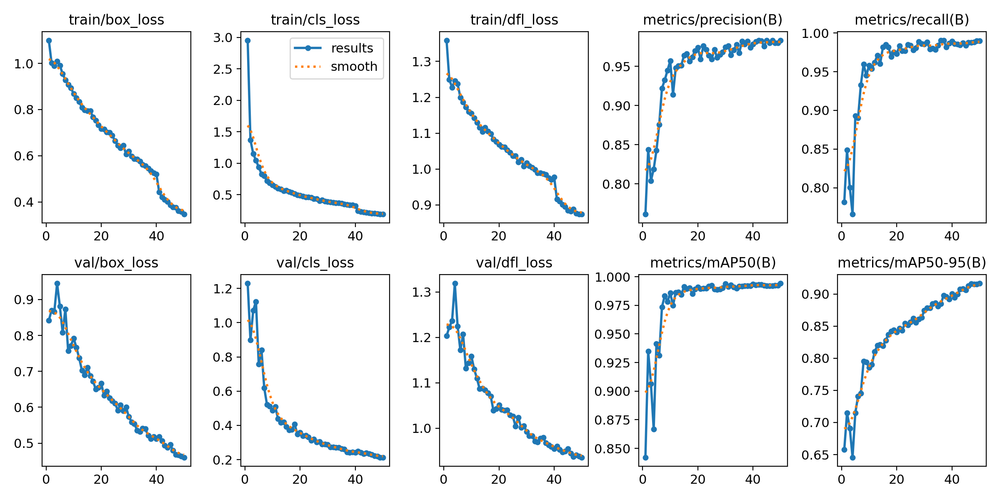

In [5]:
display_image("/kaggle/input/yolov8-model-outputs/kaggle/working/runs/detect/train/results.png")

#### While the model detects and classifies most of the objects correctly, it fails to identify some of the objects and instead classifies them as background,i.e., no object in the image.

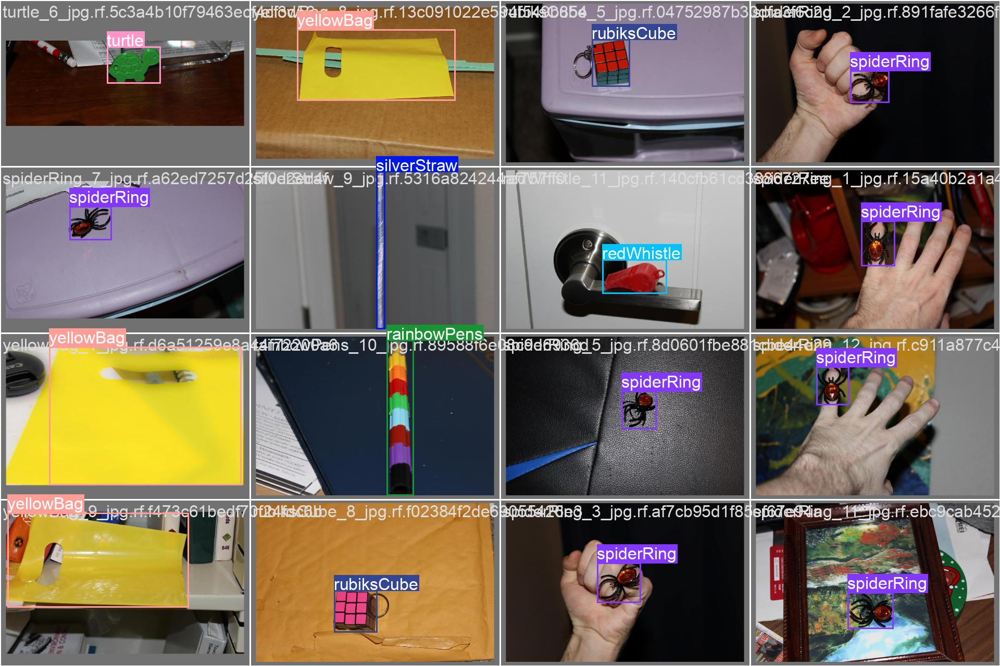

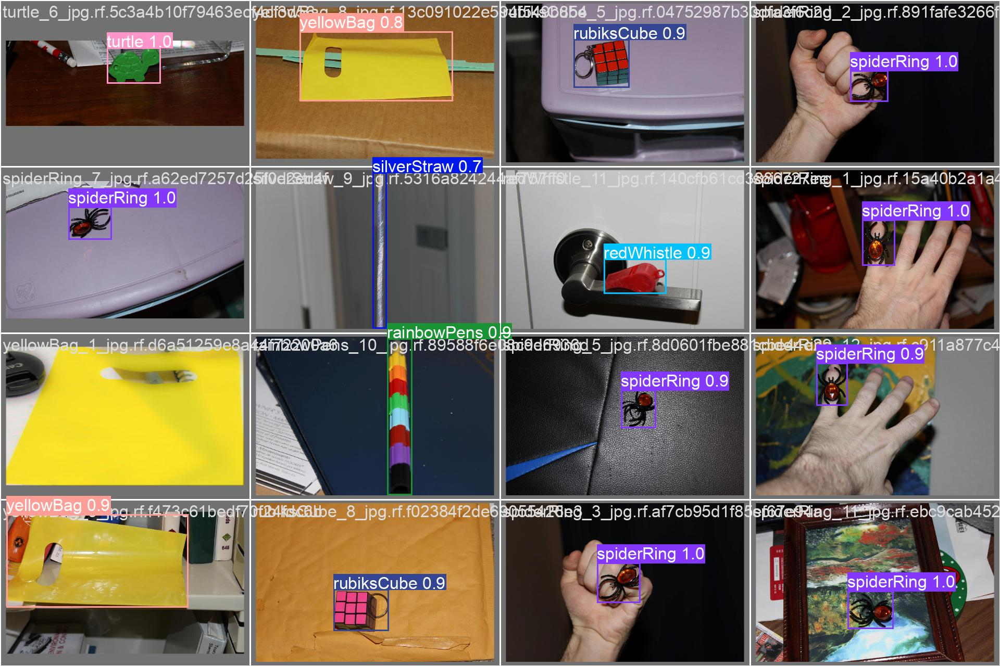

In [6]:
display_image("/kaggle/input/yolov8-model-outputs/kaggle/working/runs/detect/train/val_batch0_labels.jpg")
print("\n")
display_image("/kaggle/input/yolov8-model-outputs/kaggle/working/runs/detect/train/val_batch0_pred.jpg")

In [7]:
yolo_test_1 = YOLO('/kaggle/input/yolov8-model-outputs/kaggle/working/runs/detect/train/weights/best.pt')

In [ ]:
source = "/kaggle/input/objectsearch-test/objectsearch-test/**/*"

result_yolov8 = yolo_test_1.predict(source, save= True, save_conf = True, show_conf=True, show_boxes = True, save_txt = True)



image 1/907 /kaggle/input/objectsearch-test/objectsearch-test/Person1/Person1_1.jpg: 480x640 (no detections), 72.6ms
image 2/907 /kaggle/input/objectsearch-test/objectsearch-test/Person1/Person1_10.jpg: 640x480 (no detections), 67.5ms
image 3/907 /kaggle/input/objectsearch-test/objectsearch-test/Person1/Person1_11.jpg: 480x640 1 hairRoller, 14.5ms
image 4/907 /kaggle/input/objectsearch-test/objectsearch-test/Person1/Person1_2.jpg: 480x640 (no detections), 13.8ms
image 5/907 /kaggle/input/objectsearch-test/objectsearch-test/Person1/Person1_3.jpg: 480x640 (no detections), 13.8ms
image 6/907 /kaggle/input/objectsearch-test/objectsearch-test/Person1/Person1_4.jpg: 640x640 1 miniCards, 16.2ms
image 7/907 /kaggle/input/objectsearch-test/objectsearch-test/Person1/Person1_5.jpg: 480x640 (no detections), 14.5ms
image 8/907 /kaggle/input/objectsearch-test/objectsearch-test/Person1/Person1_6.jpg: 480x640 (no detections), 13.7ms
image 9/907 /kaggle/input/objectsearch-test/objectsearch-test/Person

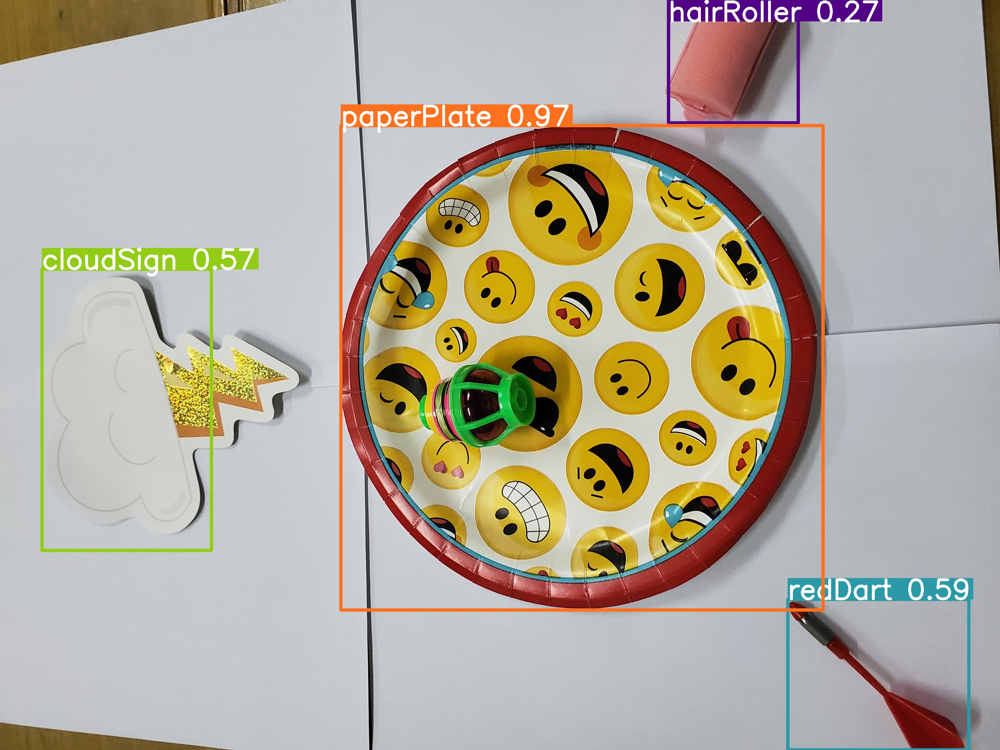

In [8]:
display_image("/kaggle/working/runs/detect/predict/Person37_15.jpg")

In [9]:
validation_metrics = yolo_test_1.val(plots = True)

Ultralytics YOLOv8.2.28 🚀 Python-3.10.13 torch-2.1.2 CUDA:0 (Tesla P100-PCIE-16GB, 16276MiB)
Model summary (fused): 218 layers, 25864657 parameters, 0 gradients, 78.8 GFLOPs


val: Scanning /kaggle/input/cgcs-yolo-training/cgcs-data-yolov5/valid/labels... 505 images, 0 backgrounds, 0 corrupt: 100%|██████████| 505/505 [00:02<00:00, 190.65it/s]


val: WARNING ⚠️ Cache directory /kaggle/input/cgcs-yolo-training/cgcs-data-yolov5/valid is not writeable, cache not saved.
WARNING ⚠️ Box and segment counts should be equal, but got len(segments) = 37, len(boxes) = 516. To resolve this only boxes will be used and all segments will be removed. To avoid this please supply either a detect or segment dataset, not a detect-segment mixed dataset.


/opt/conda/lib/python3.10/multiprocessing/popen_fork.py:66: RuntimeWarning: os.fork() was called. os.fork() is incompatible with multithreaded code, and JAX is multithreaded, so this will likely lead to a deadlock.
  self.pid = os.fork()
                 Class     Images  Instances      Box(P          R      mAP50  mAP50-95): 100%|██████████| 32/32 [00:09<00:00,  3.47it/s]


                   all        505        516      0.983       0.99      0.994      0.916
              birdCall         10         10          1          1      0.995      0.944
        blueSunglasses          6          6      0.959          1      0.995      0.904
              brownDie         11         11       0.98          1      0.995      0.875
           cactusPaper          8          8      0.968          1      0.995      0.983
          canadaPencil          8          8      0.979          1      0.995      0.919
             carabiner         15         15      0.983          1      0.995      0.976
             cloudSign         11         11          1          1      0.995       0.97
               cowbell         12         12      0.944          1      0.995      0.969
          cupcakePaper         10         10          1          1      0.995      0.955
               eyeball          9          9      0.971          1      0.995      0.959
              foamDar

In [10]:
# inferring results from the table above:

from io import StringIO

data = """
Class     Images  Instances      Box(P          R      mAP50  mAP50-95
all        505        516      0.983       0.99      0.994      0.916
birdCall         10         10          1          1      0.995      0.944
blueSunglasses          6          6      0.959          1      0.995      0.904
brownDie         11         11       0.98          1      0.995      0.875
cactusPaper          8          8      0.968          1      0.995      0.983
canadaPencil          8          8      0.979          1      0.995      0.919
carabiner         15         15      0.983          1      0.995      0.976
cloudSign         11         11          1          1      0.995       0.97
cowbell         12         12      0.944          1      0.995      0.969
cupcakePaper         10         10          1          1      0.995      0.955
eyeball          9          9      0.971          1      0.995      0.959
foamDart         14         14      0.981          1      0.995      0.956
gClamp         12         12       0.98          1      0.995      0.962
giftBag         12         12      0.979          1      0.995       0.97
glassBead          7         18      0.985      0.944      0.966      0.846
gyroscope          8          8      0.968          1      0.995      0.984
hairClip         10         10      0.976          1      0.995      0.949
hairRoller         16         16      0.985          1      0.995      0.908
lavenderDie         11         11      0.984          1      0.995      0.826
legoBracelet         11         11      0.982          1      0.995      0.907
metalKey         13         13          1          1      0.995      0.913
miniCards         13         13      0.974          1      0.995      0.946
noiseMaker         11         11      0.979          1      0.995      0.916
paperPlate         10         10          1          1      0.995      0.989
partyFavor         14         14      0.985          1      0.995      0.869
pinkCandle         13         13      0.985          1      0.995      0.757
pinkEraser          9          9          1          1      0.995       0.92
plaidPencil          9          9          1      0.988      0.995      0.923
pumpkinNotes         13         13      0.979          1      0.995      0.963
rainbowPens         14         14      0.984          1      0.995      0.886
redBow          6          6       0.96          1      0.995      0.931
redDart          9          9          1          1      0.995      0.889
redWhistle         12         12      0.977          1      0.995      0.938
rubiksCube         15         15      0.984          1      0.995      0.843
sign          8          8      0.973          1      0.995      0.936
silverStraw         15         15          1      0.838      0.988       0.73
spiderRing         15         15      0.982          1      0.995      0.852
stickerBox         16         16      0.983          1      0.995      0.931
trophy         14         14      0.982          1      0.995      0.934
turtle         12         12          1          1      0.995      0.883
vancouverCards         16         16      0.983          1      0.995       0.97
voiceRecorder         12         12       0.98          1      0.995      0.946
yellowBag         18         18          1        0.8      0.995      0.857
yellowBalloon         17         17      0.981          1      0.995      0.886
"""

df = pd.read_csv(StringIO(data), sep='\s+')
df.drop(index=0, inplace=True)
print(df)

             Class  Images  Instances  Box(P      R  mAP50  mAP50-95
1         birdCall      10         10  1.000  1.000  0.995     0.944
2   blueSunglasses       6          6  0.959  1.000  0.995     0.904
3         brownDie      11         11  0.980  1.000  0.995     0.875
4      cactusPaper       8          8  0.968  1.000  0.995     0.983
5     canadaPencil       8          8  0.979  1.000  0.995     0.919
6        carabiner      15         15  0.983  1.000  0.995     0.976
7        cloudSign      11         11  1.000  1.000  0.995     0.970
8          cowbell      12         12  0.944  1.000  0.995     0.969
9     cupcakePaper      10         10  1.000  1.000  0.995     0.955
10         eyeball       9          9  0.971  1.000  0.995     0.959
11        foamDart      14         14  0.981  1.000  0.995     0.956
12          gClamp      12         12  0.980  1.000  0.995     0.962
13         giftBag      12         12  0.979  1.000  0.995     0.970
14       glassBead       7        

In [11]:
# Classify precision based on mAP50-95 values
conditions = [
    (df['mAP50-95'] > 0.9),
    (df['mAP50-95'] > 0.7) & (df['mAP50-95'] <= 0.9),
    (df['mAP50-95'] > 0.5) & (df['mAP50-95'] <= 0.7),
    (df['mAP50-95'] <= 0.5)
]

choices = ['high precision', 'medium precision', 'low precision', 'poor precision']

df['Precision'] = np.select(conditions, choices, default='unknown')
# print(df)
high_precision = df[df['Precision'] == 'high precision']
medium_precision = df[df['Precision'] == 'medium precision']
low_precision = df[df['Precision'] == 'low precision']
poor_precision = df[df['Precision'] == 'poor precision']

print("High Precision Rows:")
print(high_precision)

print("\nMedium Precision Rows:")
print(medium_precision)

print("\nLow Precision Rows:")
print(low_precision)

print("\nPoor Precision Rows:")
print(poor_precision)

High Precision Rows:
             Class  Images  Instances  Box(P      R  mAP50  mAP50-95  \
1         birdCall      10         10  1.000  1.000  0.995     0.944   
2   blueSunglasses       6          6  0.959  1.000  0.995     0.904   
4      cactusPaper       8          8  0.968  1.000  0.995     0.983   
5     canadaPencil       8          8  0.979  1.000  0.995     0.919   
6        carabiner      15         15  0.983  1.000  0.995     0.976   
7        cloudSign      11         11  1.000  1.000  0.995     0.970   
8          cowbell      12         12  0.944  1.000  0.995     0.969   
9     cupcakePaper      10         10  1.000  1.000  0.995     0.955   
10         eyeball       9          9  0.971  1.000  0.995     0.959   
11        foamDart      14         14  0.981  1.000  0.995     0.956   
12          gClamp      12         12  0.980  1.000  0.995     0.962   
13         giftBag      12         12  0.979  1.000  0.995     0.970   
15       gyroscope       8          8  0.96

### The Custom model trained on the manually annotated TrainingImages data is able to detect and classify the objects with high precision as seen above.
#### I chose mAP(50-95) as the metric to compare the different classes' identification because it gives a comprehensive view of the model's performance across different levels of detection difficulty.

## Q2. Demonstrate your process for using visual analytics to correct for classification errors in the results. How do you represent confidence and uncertainty? How could the correction process be made more efficient?

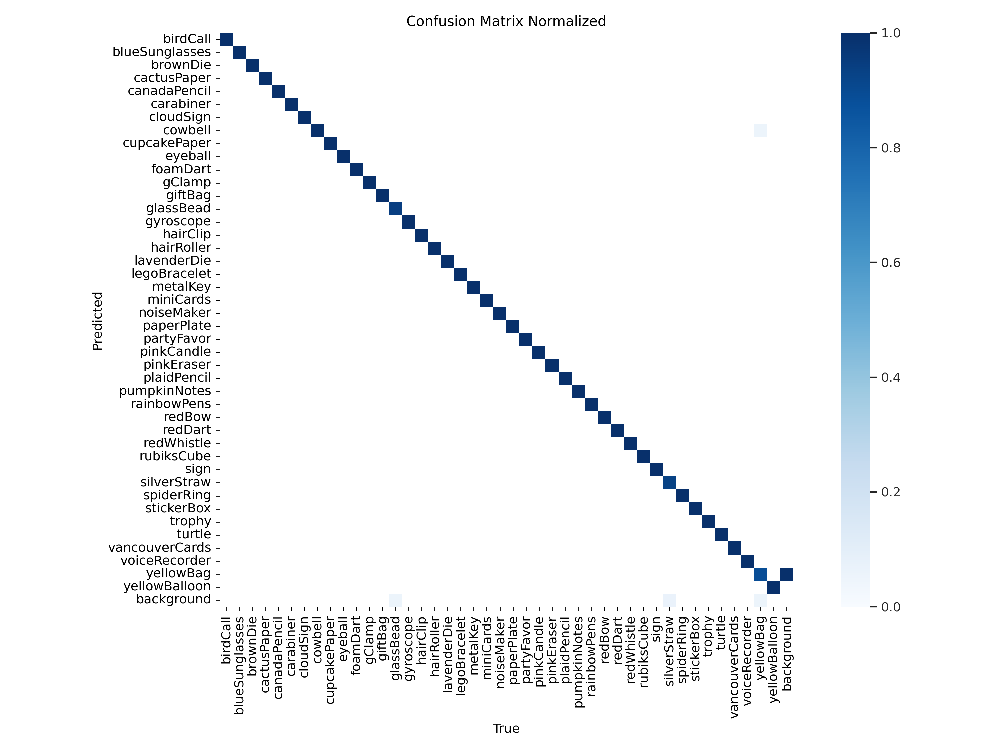

In [12]:
display_image("/kaggle/input/yolov8-model-outputs/kaggle/working/runs/detect/train/confusion_matrix_normalized.png")

#### Due to lack of knowledge in labelling tools like LabelImg and CVAT, I was unable to correct the mis-classifications on the Test Dataset. Ideally the correction process can be made more efficient by using semi-supervised learning: Leverage predictions with high confidence to auto-label a portion of the dataset. Second suggestion would be Active learning: Prioritize human review of images where the model has low confidence or high disagreement with ground truth.

## 3. Characterize the distribution of objects across the forty people.

    1. Which people have which objects? 

    2. Identify groups of people that have object(s) in common. 


In [13]:
def create_dataframe_from_labels(labels_dir, classes_dict):
    data = []
    for subdir, dirs, files in os.walk(labels_dir):
        for file in files:
            if file.endswith(".txt"):
                person = file.split('_')[0]  # Extract person from filename
                with open(os.path.join(subdir, file), 'r') as f:
                    lines = f.readlines()
                    for line in lines:
                        parts = line.strip().split()
                        class_id = int(parts[0])
                        class_name = classes_dict[class_id]
                        x, y, width, height, confidence = map(float, parts[1:])
                        data.append([class_name, x, y, width, height, confidence, person])
    df = pd.DataFrame(data, columns=['class', 'x', 'y', 'width', 'height', 'confidence', 'person'])
    return df

# Dictionary of classes
classes = {
    0: 'birdCall', 1: 'blueSunglasses', 2: 'brownDie', 3: 'cactusPaper', 4: 'canadaPencil', 5: 'carabiner', 
    6: 'cloudSign', 7: 'cowbell', 8: 'cupcakePaper', 9: 'eyeball', 10: 'foamDart', 11: 'gClamp', 12: 'giftBag', 
    13: 'glassBead', 14: 'gyroscope', 15: 'hairClip', 16: 'hairRoller', 17: 'lavenderDie', 18: 'legoBracelet', 
    19: 'metalKey', 20: 'miniCards', 21: 'noiseMaker', 22: 'paperPlate', 23: 'partyFavor', 24: 'pinkCandle', 
    25: 'pinkEraser', 26: 'plaidPencil', 27: 'pumpkinNotes', 28: 'rainbowPens', 29: 'redBow', 30: 'redDart', 
    31: 'redWhistle', 32: 'rubiksCube', 33: 'sign', 34: 'silverStraw', 35: 'spiderRing', 36: 'stickerBox', 
    37: 'trophy', 38: 'turtle', 39: 'vancouverCards', 40: 'voiceRecorder', 41: 'yellowBag', 42: 'yellowBalloon'
}

labels_dir = '/kaggle/working/runs/detect/predict/labels'
# Create DataFrame from labels
detection_df = create_dataframe_from_labels(labels_dir, classes)
print(detection_df)

           class         x         y     width    height  confidence    person
0      glassBead  0.639413  0.937359  0.084383  0.117627    0.813697   Person3
1      glassBead  0.779786  0.955881  0.095905  0.088196    0.811636   Person3
2      glassBead  0.852919  0.881398  0.092226  0.126811    0.791096   Person3
3      glassBead  0.682869  0.306522  0.070465  0.093001    0.698019   Person3
4      glassBead  0.088691  0.558376  0.063298  0.082289    0.629214   Person3
..           ...       ...       ...       ...       ...         ...       ...
531  cactusPaper  0.398562  0.521197  0.448088  0.789774    0.905312   Person9
532    miniCards  0.556423  0.545118  0.414750  0.351221    0.942101  Person39
533   paperPlate  0.571758  0.503871  0.481585  0.989721    0.907911  Person13
534  lavenderDie  0.466157  0.508477  0.041171  0.053082    0.274943  Person16
535  cactusPaper  0.417260  0.417164  0.360449  0.683754    0.708629   Person9

[536 rows x 7 columns]


In [14]:
people_objects = detection_df.groupby('person')['class'].apply(list).reset_index()

# Display the result
print("Distribution of people with different objects:\n")
print(people_objects)

Distribution of people with different objects:

      person                                              class
0    Person1             [yellowBalloon, miniCards, hairRoller]
1   Person10  [plaidPencil, plaidPencil, plaidPencil, plaidP...
2   Person11  [carabiner, giftBag, cupcakePaper, cupcakePape...
3   Person12  [pumpkinNotes, cupcakePaper, pumpkinNotes, noi...
4   Person13  [partyFavor, miniCards, blueSunglasses, paperP...
5   Person14  [cloudSign, canadaPencil, miniCards, miniCards...
6   Person15  [sign, lavenderDie, hairRoller, voiceRecorder,...
7   Person16             [cowbell, redBow, trophy, lavenderDie]
8   Person17  [glassBead, glassBead, glassBead, rubiksCube, ...
9   Person18  [lavenderDie, redWhistle, redBow, lavenderDie,...
10  Person19  [gClamp, gClamp, paperPlate, gClamp, paperPlat...
11   Person2  [lavenderDie, brownDie, yellowBalloon, yellowB...
12  Person21                               [yellowBag, cowbell]
13  Person22  [stickerBox, blueSunglasses, stickerBox, f

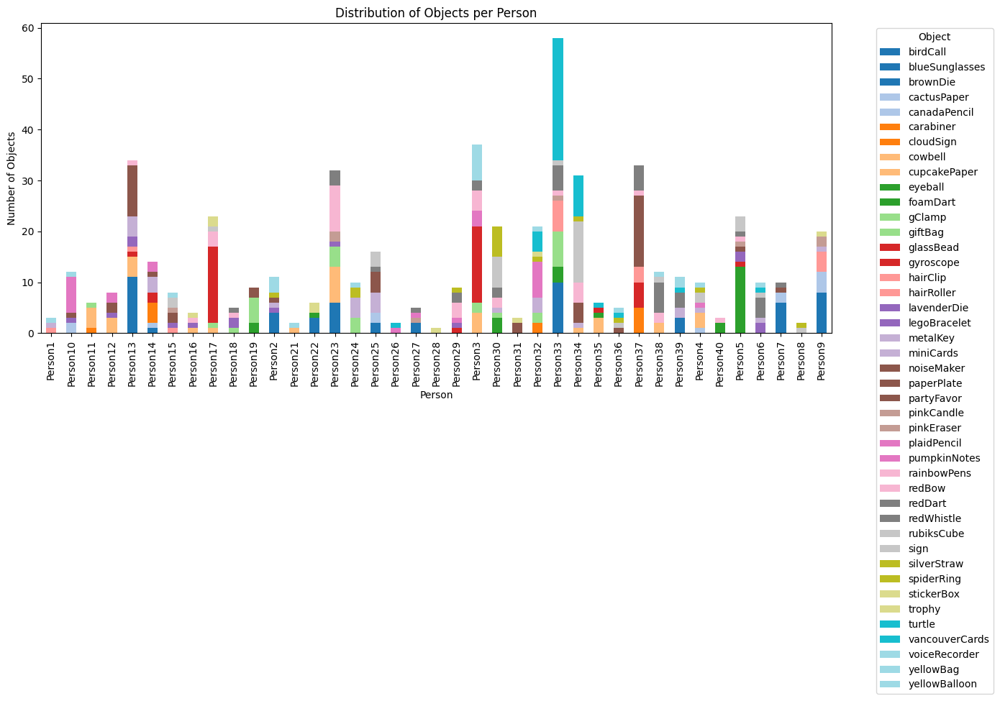

In [15]:
person_object_distribution = detection_df.groupby(['person', 'class']).size().unstack(fill_value=0)

# Plot a stacked bar plot
person_object_distribution.plot(kind='bar', stacked=True, figsize=(14, 8), colormap='tab20')
plt.xlabel('Person')
plt.ylabel('Number of Objects')
plt.title('Distribution of Objects per Person')
plt.legend(title='Object', bbox_to_anchor=(1.05, 1), loc='upper left')
plt.xticks(rotation=90)
plt.tight_layout()
plt.show()

In [16]:
person_objects = detection_df.groupby('person')['class'].apply(set).reset_index()

# Create a dictionary to map each object to the list of people who have it
object_people = {}
for person, objects in zip(person_objects['person'], person_objects['class']):
    for obj in objects:
        if obj not in object_people:
            object_people[obj] = set()
        object_people[obj].add(person)

# Convert the dictionary to a DataFrame for better readability
object_people_df = pd.DataFrame([(obj, list(people)) for obj, people in object_people.items()], columns=['object', 'people'])
object_people_df = object_people_df.sort_values(by = ['object'])
# Display the result
print(object_people_df.to_markdown())

|    | object         | people                                                                                                                                         |
|---:|:---------------|:-----------------------------------------------------------------------------------------------------------------------------------------------|
| 14 | birdCall       | ['Person13', 'Person33', 'Person14']                                                                                                           |
| 19 | blueSunglasses | ['Person2', 'Person7', 'Person27', 'Person22', 'Person39', 'Person9', 'Person13']                                                              |
| 33 | brownDie       | ['Person2', 'Person7', 'Person33', 'Person25', 'Person23']                                                                                     |
|  6 | cactusPaper    | ['Person10', 'Person7', 'Person9']                                                                                                 

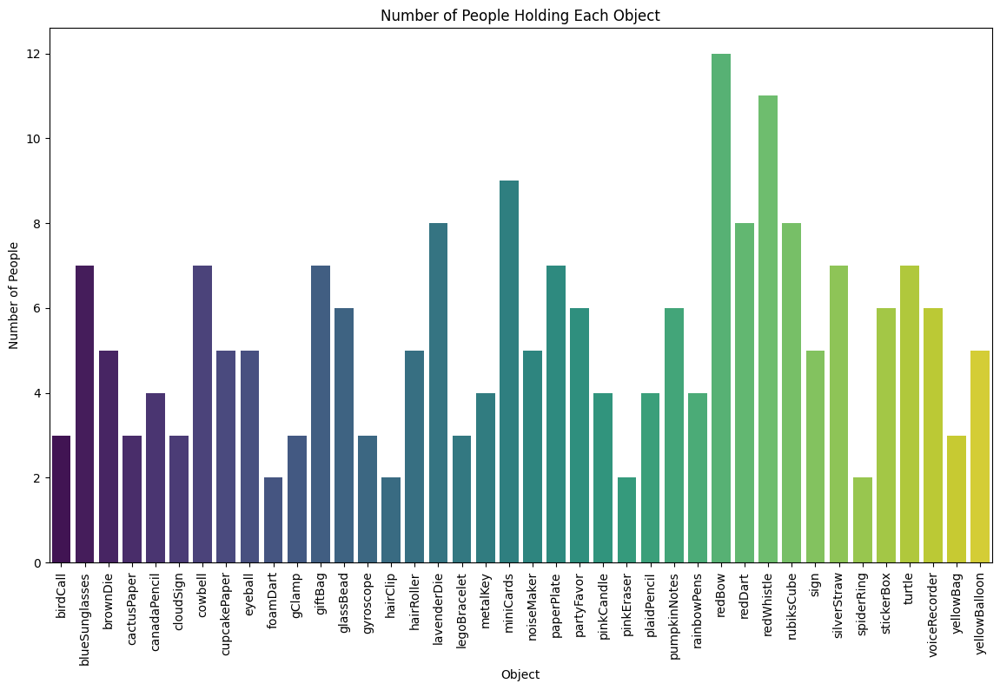

In [17]:
# 1. Identify Unique Objects per Person
person_object_count = detection_df.groupby('person')['class'].nunique().reset_index()
person_object_count.columns = ['person', 'unique_objects_count']

# 2. Identify Common Objects Among Subgroups
common_objects = detection_df.groupby('class')['person'].nunique().reset_index()
common_objects.columns = ['class', 'unique_persons_count']

# Filter objects that are held by multiple individuals
common_objects = common_objects[common_objects['unique_persons_count'] > 1]

# Plot the distribution of these common objects
plt.figure(figsize=(14, 8))
sns.barplot(x='class', y='unique_persons_count', data=common_objects, palette='viridis')
plt.xticks(rotation=90)
plt.xlabel('Object')
plt.ylabel('Number of People')
plt.title('Number of People Holding Each Object')
plt.show()


In [18]:
# Find objects that are common among exactly 8 people
potential_totem_objects = common_objects[common_objects['unique_persons_count'] == 8]

print("Potential Totem Objects:")
print(potential_totem_objects)

# Identify the group of people holding the potential totem objects
totem_holders = detection_df[detection_df['class'].isin(potential_totem_objects['class'])]
totem_holders_grouped = totem_holders.groupby('class')['person'].apply(lambda x: list(set(x))).reset_index()

print("People holding potential totem objects:")
print(totem_holders_grouped.to_string())

Potential Totem Objects:
          class  unique_persons_count
17  lavenderDie                     8
30      redDart                     8
32   rubiksCube                     8
People holding potential totem objects:
         class                                                                           person
0  lavenderDie   [Person2, Person15, Person10, Person6, Person23, Person18, Person29, Person16]
1      redDart  [Person37, Person30, Person33, Person39, Person25, Person38, Person23, Person3]
2   rubiksCube     [Person17, Person30, Person5, Person6, Person38, Person8, Person4, Person34]


### It seems there might be 3 potential totems in the possession of exactly 8 different people. 

### I am going to cross-verify with the images since the model might have mis-classified some images.

In [19]:
totem_dict = totem_holders_grouped.set_index('class')['person'].to_dict()
coi = ['lavenderDie', 'redDart', 'rubiksCube']
totem_class_id = {cls: i for i,cls in enumerate(df['Class'])if cls in coi}

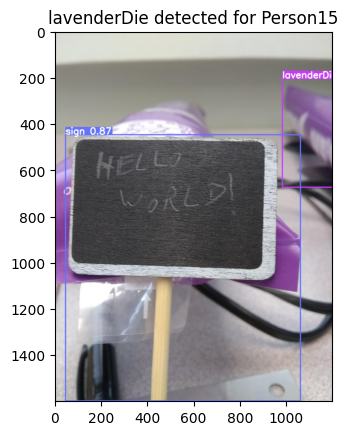

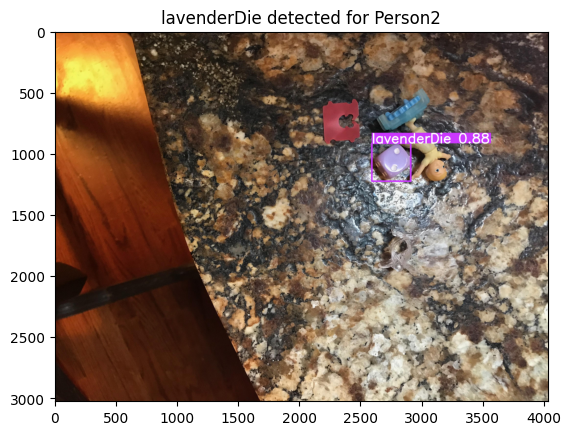

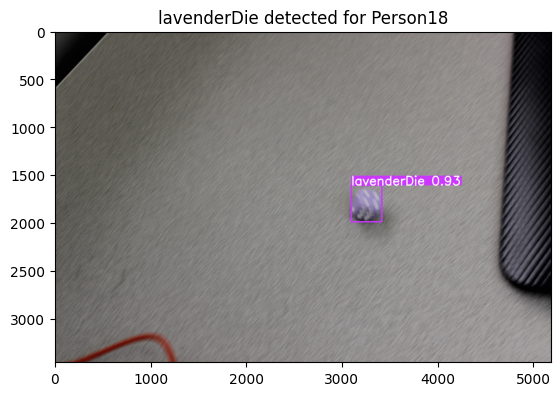

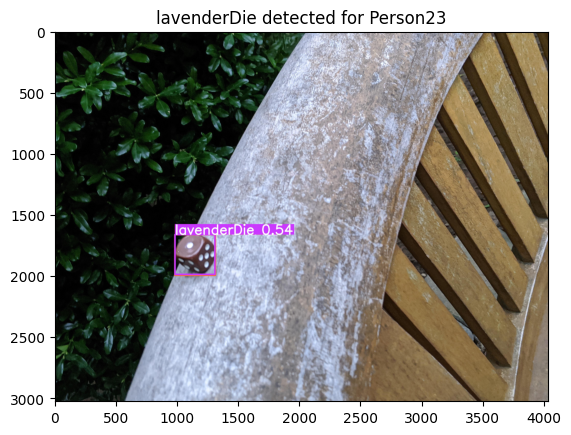

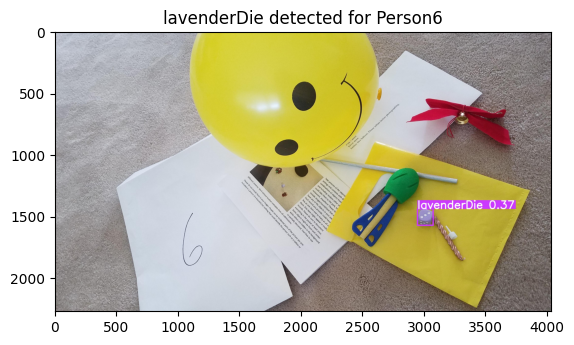

...

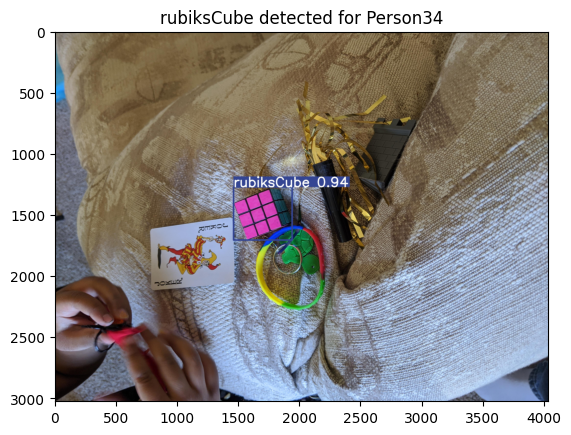

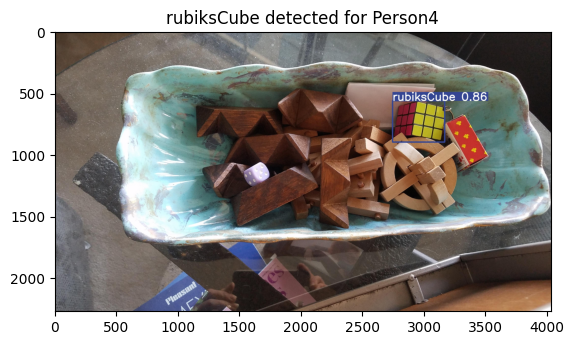

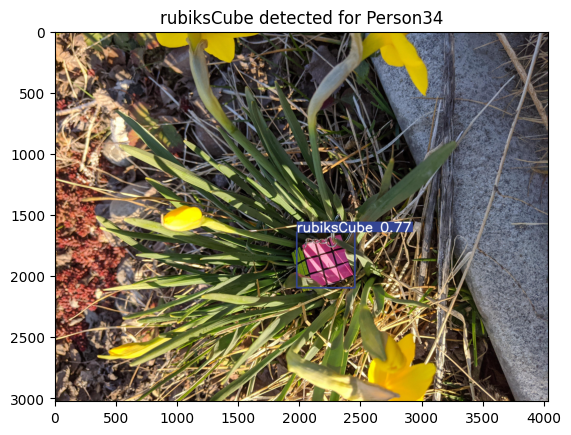

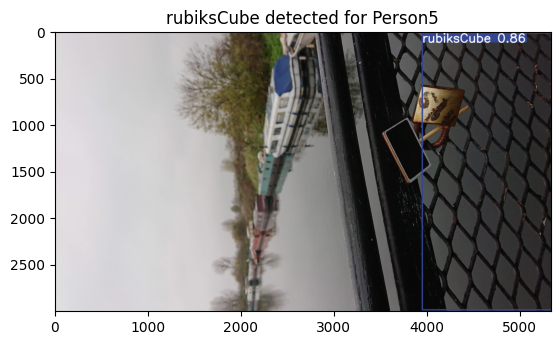

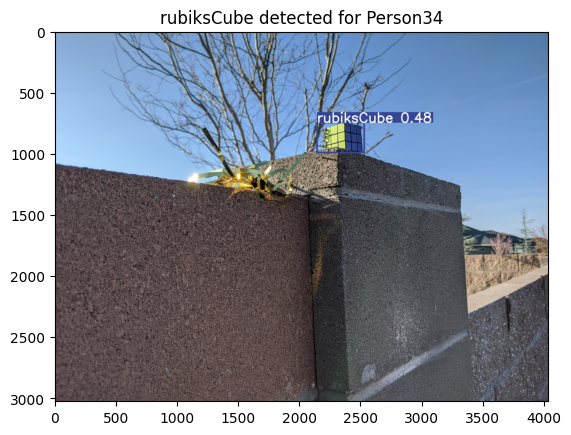

In [22]:
labels_folder_path = '/kaggle/working/runs/detect/predict/labels'
images_folder_path = '/kaggle/working/runs/detect/predict'

def show_images_with_class(label_files, class_name, person_list):
    category_id = totem_class_id[class_name]
    
    for label_file in label_files:
        # Extract the person ID from the label file name
        person_id = label_file.split('_')[0]
        
        if person_id in person_list:
            with open(os.path.join(labels_folder_path, label_file), 'r') as file:
                lines = file.readlines()
                for line in lines:
                    parts = line.strip().split()
                    if int(parts[0]) == category_id:
                        # Construct image file path (assuming image file names follow a specific naming convention)
                        image_file = label_file.replace('.txt', '.jpg')  # Adjust extension if different
                        image_path = os.path.join(images_folder_path, image_file)
                        
                        # Read and display the image
                        image = cv2.imread(image_path)
                        if image is not None:
                            plt.figure()
                            plt.imshow(cv2.cvtColor(image, cv2.COLOR_BGR2RGB))
                            plt.title(f'{class_name} detected for {person_id}')
                            plt.show()

# Get the list of label files
label_files = os.listdir(labels_folder_path)

# Show images for each class and corresponding persons
for class_name, persons in totem_dict.items():
    show_images_with_class(label_files, class_name, persons)

### The cross-verification of the images is successful in this case, because there is evidence of many False positive detection and identification of the objects: 'redDart' and 'rubiksCube'.
### The Totem is likely the 'lavenderDie' with the group of people being: 
1. Person2
2. Person15
3. Person10
4. Person6
5. Person23
6. Person18
7. Person29
8. Person16

## 5. Process question: Did you choose to use the object recognition model results provided or use your own machine learning algorithm? Why did you make that choice? What was the biggest challenge you faced? 

### I initially chose to use the object recognition model results (yolov2) provided to set a baseline of what data analysis I could perform on the detected results, and how effective the model was on the unseen Testing dataset.

### <br> The object recognition model did not give me good results. The reason is that the data only provides one score for each bounding box, which hinders us from reasoning the decision's uncertainty. As the score only represents the detector's confidence that the bounding box contains the specific object, it does not tell the uncertainty of this decision. Considering that most object detectors also provide the score distribution for each bounding box, I switched over to training my own YOLOv8m model using the TrainingImages dataset that contains about 516 images(12 images per class). 

### The biggest challenge I faced was the manual annotation of the Training Images. It was the first time I had ever performed annotations on a image dataset, so there was a lot of room for imporvement. Sometimes, the model had trouble detecting an object among a crowded background, or if there were too many objects of interest, the model would not detect any object. 

### This model, while having good performance metrics on the training and validation datasets, did not perform as well on the Testing Image.